In [1]:
import sys
import os

# Get the parent directory of the current folder
project_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
if project_dir not in sys.path:
    sys.path.insert(0, project_dir)


In [ ]:
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import minimize
from tqdm import tqdm
from scipy.stats import t, multivariate_normal, multivariate_t
from scipy.special import logsumexp, gamma, gammaln
from numpy.linalg import inv, det, slogdet, LinAlgError
import plotly.express as px
from plotly.subplots import make_subplots
from numpy import tril_indices, triu_indices
from typing import Literal, Optional, Dict, Union


from Functions.simulation_1 import * 
from Functions.gas_filter_5 import *
from Functions.kf_filter_5 import *

# 3x3 Linear State Space

## When there is no correlation between state and measurement noise

In [3]:
# Explicit parameters with regressors
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_no_correl = np.array([[0.8, 0.0, 0.0],
                         [0.0, 0.9, 0.0],
                         [0.0, 0.0, 0.7]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_no_correl = np.array([[0.7, 0.0, 0.0],
                                 [0.0, 0.5, 0.0],
                                 [0.0, 0.0, 0.6]])

R_true_3x3_no_correl = np.array([[0.4, 0.0, 0.0],
                                 [0.0, 0.8, 0.0],
                                 [0.0, 0.0, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_no_correl, mu_sim_3x3_no_correl, X_sim_3x3_no_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_no_correl,
    beta=beta_true_3x3,  # Explicitly include regressors
    Q=Q_true_3x3_no_correl,
    R=R_true_3x3_no_correl,
    use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")


✅ Multivariate State-Space Simulation with regressors completed.


In [4]:
X_sim_3x3_no_correl

array([[-0.41122049, -0.04992794,  0.18260338],
       [ 2.48747401,  0.17345768, -1.10596946],
       [-0.60659156,  0.09452377,  1.1628231 ],
       ...,
       [ 0.85522511, -1.72254365,  1.61355302],
       [-0.72951084, -0.02980827, -0.17231074],
       [ 0.75574563, -1.5722478 , -1.28498974]], shape=(1000, 3))

In [5]:
gas_results_3x3_no_correl_1 = estimate_and_filter_gas(
    y=y_sim_3x3_no_correl,
    X=X_sim_3x3_no_correl, 
    phi_type="diagonal",
    kappa_type="full", 
    fix_nu=None)


mu_gas_3x3_no_correl_1 = gas_results_3x3_no_correl_1["mu_filtered"]
u_gas_3x3_no_correl_1 = gas_results_3x3_no_correl_1["u"]
resid_gas_no_correl_1 = gas_results_3x3_no_correl_1["resid"]
Kappa_est_3x3_no_correl_1 = gas_results_3x3_no_correl_1["Kappa"]

Estimated omega:
 [ 1.18769359 -0.92277462  1.30055838]
Estimated Phi:
 [[0.78463192 0.         0.        ]
 [0.         0.89030414 0.        ]
 [0.         0.         0.69665259]]
Estimated beta:
 [[ 1.04421166 -0.54193239  0.21172696]
 [-1.2253587   0.73078327  0.42802181]
 [ 0.52509892  1.4875123  -0.27759614]]
Estimated Omega (from lambda):
 [[1.1402079  0.         0.        ]
 [0.         1.64366524 0.        ]
 [0.         0.         1.19539551]]
Estimated Kappa:
 [[ 0.64163612  0.0352898   0.00244671]
 [ 0.10652148  0.83285835 -0.03214878]
 [-0.01641126 -0.05602893  0.46266955]]
Estimated nu:
 145.1459872093008
Log-likelihood: -4680.292186296037
AIC: 9416.584372592073
BIC: 9584.76266448628


In [6]:
kf_results_3x3_no_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_no_correl,
    X=X_sim_3x3_no_correl,
    initial_params=None,
    verbose=True,
    max_iter=1000
)

mu_kf_3x3_no_correl = kf_results_3x3_no_correl['mu_filtered']
P_kf_3x3_no_correl = kf_results_3x3_no_correl['P_filtered']
kalman_gain_kf_3x3_no_correl = kf_results_3x3_no_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [ 1.17149711 -0.92995868  1.31974863]
Phi (persistence matrix): 
[[ 0.73378616  0.02424565 -0.01707693]
 [ 0.03758229  0.92714488 -0.03040058]
 [-0.0220877  -0.01141044  0.65343522]]
beta: 
[[ 1.04491448 -0.53807502  0.2115541 ]
 [-1.22167809  0.73310668  0.42773515]
 [ 0.52104768  1.48067522 -0.27324111]]
Q (state noise covariance): 
[[0.65752033 0.00081088 0.02312753]
 [0.00081088 0.45382502 0.00070219]
 [0.02312753 0.00070219 0.49784893]]
R (observation noise covariance): 
[[3.52211496e-01 5.93473248e-04 5.93473248e-04]
 [5.93473248e-04 8.70738034e-01 6.11867149e-03]
 [5.93473248e-04 6.11867149e-03 5.65203588e-01]]
Log-likelihood: -4698.650958122255
AIC: 9463.30191624451
BIC: 9661.51204597697


In [7]:
mu_sim_3x3_no_correl

array([[ 1.        , -1.        ,  1.33333333],
       [ 1.62874376, -2.22861833,  2.90843308],
       [ 2.26694761, -0.79601099,  1.83817919],
       ...,
       [ 0.40470217, -1.34485871,  1.47857998],
       [ 0.58912586, -0.80815352,  1.75000884],
       [-0.2001978 , -0.71950501,  1.76755857]], shape=(1000, 3))

In [8]:
T_3x3, R_3x3 = mu_sim_3x3_no_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_no_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])

for i in range(R_3x3):
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=y_sim_3x3_no_correl[:, i],
                             mode='lines', name=f'y[{i+1}] (Observed)',
                             line=dict(color='gray', width=1.5, dash='dot')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_sim_3x3_no_correl[:, i],
                             mode='lines', name=f'mu_true[{i+1}]',
                             line=dict(color='blue', width=2)),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_gas_3x3_no_correl_1[:, i],
                             mode='lines', name=f'mu_gas[{i+1}]',
                             line=dict(color='red', width=2, dash='dash')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_kf_3x3_no_correl[:, i],
                             mode='lines', name=f'mu_kf_3x3[{i+1}]',
                             line=dict(color='green', width=2, dash='dash')),
                  row=i+1, col=1)

fig_3x3_no_correl.update_layout(height=300*R_3x3, width=950,
                  title_text="GAS Filter: True vs Filtered Latent States",
                  template="plotly_white",
                  showlegend=True)

fig_3x3_no_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_no_correl.update_yaxes(title_text="Value")

fig_3x3_no_correl.show()


note that if you set a component of $\Phi$ to be small, there is little persistence in the states

there is also the issue of the magnitude of the elements in Q the state noise

so when the signal to noise is moderate combined with low persistence the true state becomes highly volatile with little structure. GAS filter needs residuals to carry information over time


In [9]:
K = X_sim_3x3_no_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_no_correl_phi_diag_kappa_diag = {}
gas_result_3x3_no_correl_phi_diag_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_no_correl,
        X =  X_sim_3x3_no_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_no_correl,
        X =  X_sim_3x3_no_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_no_correl_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_no_correl_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_no_correl, 
    X = X_sim_3x3_no_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_no_correl, 
    X = X_sim_3x3_no_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)
# Store results for nu free estimation
gas_result_3x3_no_correl_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_no_correl_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full

Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [ 1.2128026  -0.8739581   1.28996573]
Estimated Phi:
 [[0.79339837 0.         0.        ]
 [0.         0.89000968 0.        ]
 [0.         0.         0.68819215]]
Estimated beta:
 [[ 1.05279467 -0.55433299  0.19218854]
 [-1.20836318  0.7571628   0.4323739 ]
 [ 0.5288535   1.48489651 -0.27623197]]
Estimated Omega (from lambda):
 [[0.98583494 0.         0.        ]
 [0.         1.37528231 0.        ]
 [0.         0.         1.02058144]]
Estimated Kappa:
 [[0.94874095 0.         0.        ]
 [0.         1.3081844  0.        ]
 [0.         0.         0.66864706]]
Estimated nu:
 5.0
Log-likelihood: -4786.413967953081
AIC: 9614.827935906162
BIC: 9740.961654826817


Running GAS Estimation:  14%|█▍        | 1/7 [01:02<06:15, 62.53s/it]

Estimated omega:
 [ 1.21053839 -0.88413442  1.29096742]
Estimated Phi:
 [[0.79191316 0.         0.        ]
 [0.         0.89172796 0.        ]
 [0.         0.         0.68269009]]
Estimated beta:
 [[ 1.05100698 -0.55538764  0.19390814]
 [-1.20994984  0.75395641  0.42967891]
 [ 0.530874    1.48784808 -0.28141088]]
Estimated Omega (from lambda):
 [[0.98616544 0.         0.        ]
 [0.         1.37145971 0.        ]
 [0.         0.         1.01742347]]
Estimated Kappa:
 [[ 0.94523421  0.01117581 -0.00811202]
 [ 0.10540122  1.28865832 -0.07177589]
 [-0.02085202 -0.11285617  0.66704294]]
Estimated nu:
 5.0
Log-likelihood: -4782.7577988141775
AIC: 9619.515597628355
BIC: 9781.687521954911

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [ 1.2096821  -0.90822671  1.29107433]
Estimated Phi:
 [[0.79059091 0.         0.        ]
 [0.         0.89013707 0.        ]
 [0.         0.         0.69125142]]
Estimated beta:
 [[ 1.04974773 -0.54816929  0.19691912]
 [-1.21679741  0.7491

Running GAS Estimation:  29%|██▊       | 2/7 [02:09<05:25, 65.04s/it]

Estimated omega:
 [ 1.20759495 -0.90692704  1.29191031]
Estimated Phi:
 [[0.78704415 0.         0.        ]
 [0.         0.89207468 0.        ]
 [0.         0.         0.68853179]]
Estimated beta:
 [[ 1.04825567 -0.54901575  0.19893155]
 [-1.21786499  0.74637206  0.42809493]
 [ 0.52885832  1.48882845 -0.28389274]]
Estimated Omega (from lambda):
 [[1.03539443 0.         0.        ]
 [0.         1.46018973 0.        ]
 [0.         0.         1.07799321]]
Estimated Kappa:
 [[ 0.7933472   0.02768831 -0.00193399]
 [ 0.10486388  1.0616781  -0.05845462]
 [-0.0180329  -0.08378195  0.56604504]]
Estimated nu:
 10.0
Log-likelihood: -4719.01710364242
AIC: 9492.03420728484
BIC: 9654.206131611396

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [ 1.19700401 -0.9301318   1.29532206]
Estimated Phi:
 [[0.7899504 0.        0.       ]
 [0.        0.88946   0.       ]
 [0.        0.        0.6960158]]
Estimated beta:
 [[ 1.04655304 -0.54362332  0.20492649]
 [-1.22190605  0.73910542  0.428

Running GAS Estimation:  43%|████▎     | 3/7 [03:13<04:18, 64.63s/it]

Estimated omega:
 [ 1.19481798 -0.92489845  1.29603391]
Estimated Phi:
 [[0.7849647  0.         0.        ]
 [0.         0.89112203 0.        ]
 [0.         0.         0.69398774]]
Estimated beta:
 [[ 1.04523646 -0.54463934  0.20698441]
 [-1.22377438  0.73638651  0.42779102]
 [ 0.52674975  1.48806636 -0.28096032]]
Estimated Omega (from lambda):
 [[1.09803651 0.         0.        ]
 [0.         1.5716948  0.        ]
 [0.         0.         1.15073886]]
Estimated Kappa:
 [[ 0.68615498  0.03629523  0.00191495]
 [ 0.10681964  0.90031435 -0.04190138]
 [-0.0165865  -0.06328304  0.49294066]]
Estimated nu:
 30.0
Log-likelihood: -4686.501543261104
AIC: 9427.003086522209
BIC: 9589.175010848765

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [ 1.19256735 -0.93133387  1.29752019]
Estimated Phi:
 [[0.78986136 0.         0.        ]
 [0.         0.88928468 0.        ]
 [0.         0.         0.69738568]]
Estimated beta:
 [[ 1.04593506 -0.54236412  0.20726093]
 [-1.22253298  0.7364

Running GAS Estimation:  57%|█████▋    | 4/7 [04:20<03:16, 65.60s/it]

Estimated omega:
 [ 1.19078931 -0.92867515  1.29816744]
Estimated Phi:
 [[0.78477201 0.         0.        ]
 [0.         0.89084048 0.        ]
 [0.         0.         0.69529517]]
Estimated beta:
 [[ 1.04466342 -0.54349216  0.20926656]
 [-1.22476687  0.73372247  0.42789168]
 [ 0.52605175  1.48784047 -0.2794415 ]]
Estimated Omega (from lambda):
 [[1.11724123 0.         0.        ]
 [0.         1.60486895 0.        ]
 [0.         0.         1.17170906]]
Estimated Kappa:
 [[ 0.66389719  0.03635963  0.00220867]
 [ 0.10696466  0.8666844  -0.03735667]
 [-0.01641897 -0.05948007  0.47770404]]
Estimated nu:
 50.0
Log-likelihood: -4682.580884207182
AIC: 9419.161768414364
BIC: 9581.33369274092

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [ 1.18949335 -0.93401955  1.29974299]
Estimated Phi:
 [[0.78972501 0.         0.        ]
 [0.         0.88918475 0.        ]
 [0.         0.         0.69856953]]
Estimated beta:
 [[ 1.045552   -0.54110617  0.20919775]
 [-1.22287602  0.7341

Running GAS Estimation:  71%|███████▏  | 5/7 [05:32<02:15, 67.82s/it]

Estimated omega:
 [ 1.18785193 -0.93152989  1.3003143 ]
Estimated Phi:
 [[0.78464617 0.         0.        ]
 [0.         0.89060771 0.        ]
 [0.         0.         0.69632027]]
Estimated beta:
 [[ 1.04430001 -0.54236127  0.21112888]
 [-1.22540901  0.73149999  0.42800864]
 [ 0.52540092  1.48758894 -0.27800141]]
Estimated Omega (from lambda):
 [[1.13429534 0.         0.        ]
 [0.         1.63366438 0.        ]
 [0.         0.         1.18985359]]
Estimated Kappa:
 [[ 0.64696255  0.03561196  0.00237426]
 [ 0.1067247   0.84071787 -0.03359344]
 [-0.01642959 -0.0567689   0.46616461]]
Estimated nu:
 100.0
Log-likelihood: -4680.664464387715
AIC: 9415.32892877543
BIC: 9577.500853101987

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [ 1.18705857 -0.93483842  1.30226632]
Estimated Phi:
 [[0.78951314 0.         0.        ]
 [0.         0.8890777  0.        ]
 [0.         0.         0.69953697]]
Estimated beta:
 [[ 1.04534468 -0.53978079  0.21085237]
 [-1.2230401   0.732

Running GAS Estimation:  86%|████████▌ | 6/7 [06:44<01:09, 69.38s/it]

Estimated omega:
 [ 1.18556778 -0.93334044  1.30270437]
Estimated Phi:
 [[0.7844988  0.         0.        ]
 [0.         0.89039451 0.        ]
 [0.         0.         0.6970616 ]]
Estimated beta:
 [[ 1.04412119 -0.54114173  0.21270859]
 [-1.2258644   0.72955907  0.42816071]
 [ 0.52473505  1.48735095 -0.27661603]]
Estimated Omega (from lambda):
 [[1.15035725 0.         0.        ]
 [0.         1.65995443 0.        ]
 [0.         0.         1.20628081]]
Estimated Kappa:
 [[ 0.63331806  0.03439211  0.00242334]
 [ 0.10633451  0.81965072 -0.03035933]
 [-0.01662656 -0.05473896  0.45695776]]
Estimated nu:
 500.0
Log-likelihood: -4679.955143294594
AIC: 9413.910286589187
BIC: 9576.082210915743

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [ 1.18674075 -0.93508155  1.30256483]
Estimated Phi:
 [[0.78948657 0.         0.        ]
 [0.         0.88907859 0.        ]
 [0.         0.         0.69958882]]
Estimated beta:
 [[ 1.04533633 -0.53958374  0.21105992]
 [-1.22305927  0.731

Running GAS Estimation: 100%|██████████| 7/7 [07:54<00:00, 67.80s/it]

Estimated omega:
 [ 1.18490127 -0.9324741   1.30298057]
Estimated Phi:
 [[0.78446854 0.         0.        ]
 [0.         0.89036295 0.        ]
 [0.         0.         0.69714952]]
Estimated beta:
 [[ 1.04410809 -0.54097254  0.21291466]
 [-1.22592594  0.72932421  0.42818132]
 [ 0.52463414  1.48732743 -0.27643419]]
Estimated Omega (from lambda):
 [[1.15249899 0.         0.        ]
 [0.         1.66346845 0.        ]
 [0.         0.         1.20849674]]
Estimated Kappa:
 [[ 0.631571    0.03419131  0.00242224]
 [ 0.10622217  0.81695412 -0.02992949]
 [-0.0166721  -0.05450357  0.45582196]]
Estimated nu:
 1000
Log-likelihood: -4679.927696460052
AIC: 9413.855392920104
BIC: 9576.02731724666


Estimated omega:
 [ 1.18912883 -0.94721217  1.31028259]
Estimated Phi:
 [[0.7898572  0.         0.        ]
 [0.         0.89010469 0.        ]
 [0.         0.         0.70106336]]
Estimated beta:
 [[ 1.04546841 -0.54048411  0.20991407]
 [-1.22297892  0.73284464  0.42852968]
 [ 0.52231167  1.48505125 -0.27387479]]
Estimated Omega (from lambda):
 [[1.13770623 0.         0.        ]
 [0.         1.65893507 0.        ]
 [0.         0.         1.20057543]]
Estimated Kappa:
 [[0.63911896 0.         0.        ]
 [0.         0.84331393 0.        ]
 [0.         0.         0.46481395]]
Estimated nu:
 153.694204759639
Log-likelihood: -4685.203452063198
AIC: 9414.406904126396
BIC: 9546.546990614701
Estimated omega:
 [ 1.18769359 -0.92277462  1.30055838]
Estimated Phi:
 [[0.78463192 0.         0.        ]
 [0.         0.89030414 0.        ]
 [0.         0.         0.69665259]]
Estimated beta:
 [[ 1.04421166 -0.54193239  0.21172696]
 [-1.2253587   0.73078327  0.42802181]
 [ 0.52509892  1.4875123  -

### Phi Diag, Kappa Diag

In [10]:
T, N, _ = kalman_gain_kf_3x3_no_correl.shape
nu_keys = list(gas_result_3x3_no_correl_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_no_correl[:, i, j]
        fig.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig.show()

In [11]:
# Setup
T, N, _ = kalman_gain_kf_3x3_no_correl.shape
nu_keys = list(gas_result_3x3_no_correl_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_no_correl_phi_diag_kappa_diag = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_no_correl[:, i, j]
        fig_3x3_no_correl_phi_diag_kappa_diag.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            fig_3x3_no_correl_phi_diag_kappa_diag.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_no_correl_phi_diag_kappa_diag.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_no_correl_phi_diag_kappa_diag.show()


higher dimension, gas model requires specifications the matrices

compensation effect between matrices
set up multivariate model

make some choices, is it likely that phi is full or diagonal, estimate nu to know if you are in a gaussian case when dof is high



### Phi Diag Kappa Full

In [12]:
# Setup
T, N, _ = kalman_gain_kf_3x3_no_correl.shape
nu_keys = list(gas_result_3x3_no_correl_phi_diag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_no_correl_phi_diag_kappa_full = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_no_correl[:, i, j]
        fig_3x3_no_correl_phi_diag_kappa_full.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_no_correl_phi_diag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_no_correl_phi_diag_kappa_full[nu]['Kappa'][i, j]
            fig_3x3_no_correl_phi_diag_kappa_full.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_no_correl_phi_diag_kappa_full.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_no_correl_phi_diag_kappa_full.show()

## When there is correlation between the signals driving the state dynamics: $\Phi$ is a full matrix but $Q$ and $R$ still diagonal

In [13]:
# Explicit parameters with regressors
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_full_no_noise_correl = np.array([[0.8, 0.2, 0.1],
                                                    [0, 0.85, 0.2],
                                                    [0, 0.2, 0.6]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_no_correl = np.array([[0.7, 0.0, 0.0],
                                 [0.0, 0.5, 0.0],
                                 [0.0, 0.0, 0.6]])

R_true_3x3_no_correl = np.array([[0.4, 0.0, 0.0],
                                 [0.0, 0.8, 0.0],
                                 [0.0, 0.0, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_phi_full_no_noise_correl, mu_sim_3x3_phi_full_no_noise_correl, X_sim_3x3_phi_full_no_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_full_no_noise_correl,
    beta=beta_true_3x3,  # Explicitly include regressors
    Q=Q_true_3x3_no_correl,
    R=R_true_3x3_no_correl,
    # use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")

✅ Multivariate State-Space Simulation with regressors completed.


In [14]:
np.linalg.eigvals(Phi_true_3x3_phi_full_no_noise_correl)

array([0.8       , 0.96084953, 0.48915047])

In [15]:
# def multivariate_KF_with_estimation(y, X=None, initial_params=None, verbose=True, max_iter=1000, method = 'L-BFGS-B'):
#     # --- Ensure Y and X are 2D ---
#     if y.ndim == 1:
#         y = y.reshape(-1, 1)
#     if X.ndim == 1:
#         X = X.reshape(-1, 1)
#     T, N = y.shape
#     K = X.shape[1] if X is not None else 0

#     omega_init = np.zeros(N)
#     Phi_init = 0.1 * np.eye(N).flatten()

#     if X is not None:
#         beta_init = np.zeros(K * N)
#     else:
#         beta_init = []

#     L_Q_elements = np.ones(N * (N + 1) // 2)
#     L_R_elements = np.ones(N * (N + 1) // 2)

#     if initial_params is None:
#         init_params = np.concatenate([omega_init, Phi_init, beta_init, L_Q_elements, L_R_elements])
#     else:
#         init_params = initial_params

#     bounds = [(-10, 10)] * len(init_params)

#     res = minimize(
#         kalman_multivariate_loglik,
#         init_params,
#         args=(y, X, N),
#         bounds=bounds,
#         method=method,
#         options = {
#         'maxiter': 10000,
#         'maxfun': 20000,
#         'ftol': 1e-9,
#         'gtol': 1e-6,
#         'disp': True
#         }
#     )

#     if not res.success:
#         raise RuntimeError("Kalman filter optimization failed: " + res.message)

#     idx = 0
#     omega_est = res.x[idx:idx + N]
#     idx += N

#     Phi_est = res.x[idx:idx + N * N].reshape(N, N)
#     idx += N * N

#     if X is not None:
#         beta_est = res.x[idx:idx + K * N].reshape(K, N)
#         idx += K * N
#     else:
#         beta_est = None

#     L_Q_elements_est = res.x[idx:idx + N * (N + 1) // 2]
#     idx += N * (N + 1) // 2

#     L_R_elements_est = res.x[idx:idx + N * (N + 1) // 2]

#     L_Q_est = np.zeros((N, N))
#     L_Q_est[np.tril_indices(N)] = L_Q_elements_est
#     Q_est = L_Q_est @ L_Q_est.T + 1e-6 * np.eye(N)

#     L_R_est = np.zeros((N, N))
#     L_R_est[np.tril_indices(N)] = L_R_elements_est
#     R_est = L_R_est @ L_R_est.T + 1e-6 * np.eye(N)

#     mu_filtered, P_filtered, kalman_gain = kalman_filter_multivariate(
#         y, omega_est, Phi_est, Q_est, R_est, X, beta_est
#     )

#     if verbose:
#         print("✅ Kalman estimation completed successfully.")
#         print("Estimated parameters:")
#         print(f"omega (unconditional mean): {omega_est}")
#         print(f"Phi (persistence matrix): \n{Phi_est}")
#         if beta_est is not None:
#             print(f"beta: \n{beta_est}")
#         print(f"Q (state noise covariance): \n{Q_est}")
#         print(f"R (observation noise covariance): \n{R_est}")

#     return {
#         'omega': omega_est,
#         'Phi': Phi_est,
#         'beta': beta_est,
#         'Q': Q_est,
#         'R': R_est,
#         'mu_filtered': mu_filtered,
#         'P_filtered': P_filtered,
#         'kalman_gain': kalman_gain,
#         'optimization_result': res
#     }

In [16]:
import numpy as np

# Dimensions
N = y_sim_3x3_phi_full_no_noise_correl.shape[1]
K = X_sim_3x3_phi_full_no_noise_correl.shape[1]

# Custom starting values
omega_init = np.array([0.1, 0.0, 0.2])                 # Shape (N,)
Phi_init = 0.5 * np.eye(N).flatten()                   # Shape (N*N,)
beta_init = 0.5 * np.ones((K, N)).flatten()                 # Shape (K*N,)

# Cholesky lower-triangle of Q and R (unconstrained)
L_Q_init = np.ones(N * (N + 1) // 2)                   # Length N*(N+1)/2
L_R_init = np.ones(N * (N + 1) // 2)

# Concatenate into full initial parameter vector
initial_params = np.concatenate([omega_init, Phi_init, beta_init, L_Q_init, L_R_init])


In [17]:
gas_results_3x3_phi_full_no_correl_1 = estimate_and_filter_gas(
    y=y_sim_3x3_phi_full_no_noise_correl, 
    X=X_sim_3x3_phi_full_no_noise_correl,
    phi_type= "diagonal",
    kappa_type= "full",
    fix_nu=None
    )


mu_gas_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["mu_filtered"]
u_gas_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["u"]
resid_gas_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["resid"]
Kappa_est_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["Kappa"]

Estimated omega:
 [-1.62705439  0.47757221 -0.96595477]
Estimated Phi:
 [[0.96767632 0.         0.        ]
 [0.         0.95717085 0.        ]
 [0.         0.         0.94701923]]
Estimated beta:
 [[ 6.24286537  0.60989747  2.97487227]
 [-1.22356431  0.81663957  0.36104694]
 [ 0.46070862  1.44435862 -0.27028298]]
Estimated Omega (from lambda):
 [[1.43100577 0.         0.        ]
 [0.         1.55578374 0.        ]
 [0.         0.         1.26134772]]
Estimated Kappa:
 [[0.87751515 0.31801102 0.12553552]
 [0.07056411 0.60342288 0.29720755]
 [0.03917089 0.32432584 0.27808118]]
Estimated nu:
 138.88728794411477
Log-likelihood: -4793.156151539241
AIC: 9642.312303078483
BIC: 9810.490594972689


In [18]:
kf_results_3x3_phi_full_no_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_full_no_noise_correl,
    X=X_sim_3x3_phi_full_no_noise_correl,
    initial_params=None,
    verbose=True
)

mu_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['mu_filtered']
P_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['P_filtered']
kalman_gain_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [-0.02276765  0.18716127  0.34894419]
Phi (persistence matrix): 
[[ 0.78230078  0.22364289  0.07224247]
 [-0.0052639   0.90563587  0.1646578 ]
 [-0.00841382  0.31869815  0.43185119]]
beta: 
[[ 2.06474175 -0.98889825  0.60935174]
 [-1.21226927  0.81590819  0.36800026]
 [ 0.45339983  1.45191192 -0.26286815]]
Q (state noise covariance): 
[[6.49402594e-01 8.05854574e-04 2.67311421e-02]
 [8.05854574e-04 4.19643919e-01 1.23806450e-02]
 [2.67311421e-02 1.23806450e-02 8.76268222e-01]]
R (observation noise covariance): 
[[4.46306359e-01 6.68060894e-04 3.26985906e-02]
 [6.68060894e-04 8.16081813e-01 9.52316883e-04]
 [3.26985906e-02 9.52316883e-04 2.79358667e-01]]
Log-likelihood: -4721.482522616205
AIC: 9508.96504523241
BIC: 9707.175174964868


In [19]:
K = X_sim_3x3_phi_full_no_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_phi_full_restrictdiag_kappa_diag = {}
gas_result_3x3_phi_full_restrictdiag_kappa_full = {}
gas_result_3x3_phi_full_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    res_gas_phi_full_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="full",
        kappa_type="full",
        fix_nu=nu_fixed,
        verbose=True
    )

    gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_phi_full_restrictdiag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
    gas_result_3x3_phi_full_kappa_full[nu_fixed] = res_gas_phi_full_kappa_full
    
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)



Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [0.57569102 0.5634735  0.13579239]
Estimated Phi:
 [[0.9680083  0.         0.        ]
 [0.         0.97690029 0.        ]
 [0.         0.         0.95730446]]
Estimated beta:
 [[ 3.74349206  0.61660643  1.72188384]
 [-1.23389404  0.80716662  0.36098952]
 [ 0.45915628  1.46343105 -0.26661455]]
Estimated Omega (from lambda):
 [[1.3403109  0.         0.        ]
 [0.         1.36167434 0.        ]
 [0.         0.         1.20747918]]
Estimated Kappa:
 [[1.72688749 0.         0.        ]
 [0.         1.24841883 0.        ]
 [0.         0.         0.92217255]]
Estimated nu:
 5.0
Log-likelihood: -4995.183026417596
AIC: 10032.366052835192
BIC: 10158.499771755847
Estimated omega:
 [0.74795242 0.54822838 0.25314093]
Estimated Phi:
 [[0.9699226  0.         0.        ]
 [0.         0.9616114  0.        ]
 [0.         0.         0.95339817]]
Estimated beta:
 [[ 3.70908258  0.59788178  1.73575543]
 [-1.24866575  0.79499404  0.3503071

Running GAS Estimation:  14%|█▍        | 1/7 [07:48<46:49, 468.21s/it]

Estimated omega:
 [0.91613173 0.67872244 0.3332749 ]
Estimated Phi:
 [[ 0.79505859  0.20465102  0.1010649 ]
 [-0.01608855  0.92522081  0.13082343]
 [-0.01379076  0.30632108  0.46240431]]
Estimated beta:
 [[ 3.88877532  0.72856767  1.82166645]
 [-1.2316314   0.80019753  0.3484687 ]
 [ 0.45095916  1.46347025 -0.24013804]]
Estimated Omega (from lambda):
 [[1.10781276 0.         0.        ]
 [0.         1.27764863 0.        ]
 [0.         0.         1.05877128]]
Estimated Kappa:
 [[1.10191803e+00 3.29104317e-01 1.65255539e-01]
 [4.70629465e-04 9.99124327e-01 3.76729182e-01]
 [7.73467056e-03 4.18812633e-01 7.39695534e-01]]
Estimated nu:
 5.0
Log-likelihood: -4822.190472985787
AIC: 9710.380945971574
BIC: 9908.591075704033

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [0.76327876 0.4093523  0.25738786]
Estimated Phi:
 [[0.96836271 0.         0.        ]
 [0.         0.97560047 0.        ]
 [0.         0.         0.95111029]]
Estimated beta:
 [[ 3.63633875  0.72764119  1.66

Running GAS Estimation:  29%|██▊       | 2/7 [14:34<35:58, 431.71s/it]

Estimated omega:
 [0.9310137  0.51904688 0.36294832]
Estimated Phi:
 [[ 0.79699255  0.2054558   0.09549052]
 [-0.01802904  0.91704269  0.14819906]
 [-0.01313468  0.30234961  0.46235232]]
Estimated beta:
 [[ 3.81781885  0.83885412  1.77239401]
 [-1.2253078   0.80730002  0.35665786]
 [ 0.44964913  1.4598291  -0.25226785]]
Estimated Omega (from lambda):
 [[1.16124921 0.         0.        ]
 [0.         1.36040661 0.        ]
 [0.         0.         1.11440425]]
Estimated Kappa:
 [[0.89339383 0.26593797 0.12682919]
 [0.01440848 0.82357309 0.29919814]
 [0.01031525 0.33462127 0.59260949]]
Estimated nu:
 10.0
Log-likelihood: -4758.148568835851
AIC: 9582.297137671701
BIC: 9780.50726740416

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [1.09164068 0.25322415 0.44004114]
Estimated Phi:
 [[0.96857122 0.         0.        ]
 [0.         0.9737963  0.        ]
 [0.         0.         0.94477529]]
Estimated beta:
 [[ 3.44226188  0.76511632  1.52992066]
 [-1.22046485  0.81487353  0

Running GAS Estimation:  43%|████▎     | 3/7 [20:59<27:21, 410.49s/it]

Estimated omega:
 [1.30227517 0.43709825 0.5740081 ]
Estimated Phi:
 [[ 0.79650009  0.2080551   0.0916149 ]
 [-0.01872421  0.91170801  0.157229  ]
 [-0.01489343  0.29898367  0.46649974]]
Estimated beta:
 [[ 3.42572773  0.89952598  1.55855639]
 [-1.21894786  0.81282747  0.36412621]
 [ 0.44948417  1.45514146 -0.26116791]]
Estimated Omega (from lambda):
 [[1.24057936 0.         0.        ]
 [0.         1.46704596 0.        ]
 [0.         0.         1.1811834 ]]
Estimated Kappa:
 [[0.75507511 0.22908178 0.09832745]
 [0.02529089 0.71222764 0.24639793]
 [0.01154249 0.27508867 0.48858625]]
Estimated nu:
 30.0
Log-likelihood: -4725.696289354712
AIC: 9517.392578709423
BIC: 9715.602708441882

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [1.3142204  0.25735914 0.54958748]
Estimated Phi:
 [[0.96854937 0.         0.        ]
 [0.         0.97334359 0.        ]
 [0.         0.         0.94314935]]
Estimated beta:
 [[ 3.2510988   0.72318284  1.43061404]
 [-1.21868502  0.81579851  

Running GAS Estimation:  57%|█████▋    | 4/7 [27:20<19:56, 398.82s/it]

Estimated omega:
 [1.41804451 0.43574369 0.63677294]
Estimated Phi:
 [[ 0.79627789  0.20743515  0.09300944]
 [-0.01866536  0.91010989  0.15927362]
 [-0.01581762  0.29860876  0.4675116 ]]
Estimated beta:
 [[ 3.29476346  0.88709957  1.49043008]
 [-1.21737941  0.81396639  0.36573425]
 [ 0.45016874  1.45416971 -0.2625563 ]]
Estimated Omega (from lambda):
 [[1.26430308 0.         0.        ]
 [0.         1.4982932  0.        ]
 [0.         0.         1.20017662]]
Estimated Kappa:
 [[0.72706259 0.22317047 0.09226423]
 [0.0276181  0.69092807 0.23554317]
 [0.01217492 0.26350295 0.4664788 ]]
Estimated nu:
 50.0
Log-likelihood: -4721.525077319763
AIC: 9509.050154639526
BIC: 9707.260284371985

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [1.456304   0.27124034 0.61608837]
Estimated Phi:
 [[0.96850779 0.         0.        ]
 [0.         0.97299235 0.        ]
 [0.         0.         0.94183813]]
Estimated beta:
 [[ 3.13741841  0.68790123  1.36979476]
 [-1.21716037  0.81652067 

Running GAS Estimation:  71%|███████▏  | 5/7 [34:11<13:26, 403.23s/it]

Estimated omega:
 [1.62203978 0.47300482 0.73527116]
Estimated Phi:
 [[ 0.79616158  0.20592283  0.09569158]
 [-0.01869432  0.90901301  0.16069542]
 [-0.01670191  0.29753861  0.46991849]]
Estimated beta:
 [[ 3.06895413  0.83162681  1.38397493]
 [-1.21609724  0.814758    0.36680666]
 [ 0.45089727  1.45353033 -0.26345868]]
Estimated Omega (from lambda):
 [[1.28495097 0.         0.        ]
 [0.         1.52516313 0.        ]
 [0.         0.         1.21657816]]
Estimated Kappa:
 [[0.70593381 0.21922554 0.08743296]
 [0.02977068 0.67502872 0.22706182]
 [0.01307694 0.25498463 0.44938741]]
Estimated nu:
 100.0
Log-likelihood: -4719.242178333363
AIC: 9504.484356666726
BIC: 9702.694486399185

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [1.72044246 0.3320419  0.73645964]
Estimated Phi:
 [[0.9684641  0.         0.        ]
 [0.         0.97274165 0.        ]
 [0.         0.         0.94078331]]
Estimated beta:
 [[ 2.89442042  0.59756115  1.25901048]
 [-1.21579584  0.81712056

Running GAS Estimation:  86%|████████▌ | 6/7 [39:23<06:12, 372.31s/it]

Estimated omega:
 [1.72999349 0.51221852 0.78627583]
Estimated Phi:
 [[ 0.7960584   0.20419149  0.09866372]
 [-0.01863034  0.90828432  0.16141777]
 [-0.01757041  0.29757191  0.47050522]]
Estimated beta:
 [[ 2.95935122  0.79026683  1.33347956]
 [-1.21509202  0.81545614  0.36776953]
 [ 0.45175465  1.45303375 -0.26392956]]
Estimated Omega (from lambda):
 [[1.30354275 0.         0.        ]
 [0.         1.54925564 0.        ]
 [0.         0.         1.23131438]]
Estimated Kappa:
 [[0.68880114 0.21643257 0.08339296]
 [0.03152969 0.66267175 0.2204261 ]
 [0.01398266 0.24831767 0.43545474]]
Estimated nu:
 500.0
Log-likelihood: -4718.06810815829
AIC: 9502.13621631658
BIC: 9700.346346049038

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [1.78608427 0.34763278 0.76632118]
Estimated Phi:
 [[0.96846291 0.         0.        ]
 [0.         0.97272293 0.        ]
 [0.         0.         0.94062314]]
Estimated beta:
 [[ 2.83098004  0.57865345  1.23101237]
 [-1.21562107  0.81713299  0

Running GAS Estimation: 100%|██████████| 7/7 [46:46<00:00, 400.99s/it]

Estimated omega:
 [1.84192144 0.54147589 0.83639617]
Estimated Phi:
 [[ 0.79610193  0.20295932  0.10075717]
 [-0.01864932  0.90818617  0.16158108]
 [-0.01768323  0.29730122  0.47108979]]
Estimated beta:
 [[ 2.85224999  0.76485059  1.28572311]
 [-1.21490929  0.8155311   0.36789304]
 [ 0.45191838  1.45294968 -0.26398337]]
Estimated Omega (from lambda):
 [[1.30610043 0.         0.        ]
 [0.         1.55254078 0.        ]
 [0.         0.         1.23325558]]
Estimated Kappa:
 [[0.68676428 0.21619134 0.08274249]
 [0.0317984  0.66116978 0.21955854]
 [0.01418945 0.24748765 0.43368761]]
Estimated nu:
 1000
Log-likelihood: -4717.968327737712
AIC: 9501.936655475423
BIC: 9700.146785207882


Estimated omega:
 [-1.12761283  0.43353732 -0.7496749 ]
Estimated Phi:
 [[0.96875496 0.         0.        ]
 [0.         0.97288211 0.        ]
 [0.         0.         0.94139421]]
Estimated beta:
 [[ 5.83848248  0.55023144  2.73800495]
 [-1.21650523  0.81684612  0.36861048]
 [ 0.46198557  1.45090264 -0.27207223]]
Estimated Omega (from lambda):
 [[1.51181881 0.         0.        ]
 [0.         1.61340731 0.        ]
 [0.         0.         1.37110973]]
Estimated Kappa:
 [[1.06316607 0.         0.        ]
 [0.         0.79041906 0.        ]
 [0.         0.         0.58046627]]
Estimated nu:
 171.82979061505293
Log-likelihood: -4877.345640583351
AIC: 9798.691281166703
BIC: 9930.831367655008
Estimated omega:
 [-1.62705439  0.47757221 -0.96595477]
Estimated Phi:
 [[0.96767632 0.         0.        ]
 [0.         0.95717085 0.        ]
 [0.         0.         0.94701923]]
Estimated beta:
 [[ 6.24286537  0.60989747  2.97487227]
 [-1.22356431  0.81663957  0.36104694]
 [ 0.46070862  1.44435862

In [20]:
# check for nu free
res_gas_free_phi_full_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="full", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

# Store results for nu free estimation
gas_result_3x3_phi_full_restrictdiag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_phi_full_restrictdiag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full
gas_result_3x3_phi_full_kappa_full['free'] = res_gas_free_phi_full_kappa_full


Estimated omega:
 [-8.9603638   0.50669104 -4.60571156]
Estimated Phi:
 [[ 0.79709244  0.19379481  0.11463336]
 [-0.0187689   0.91669623  0.14666993]
 [-0.01670408  0.29597731  0.47280254]]
Estimated beta:
 [[13.76838129  0.88791296  6.77457505]
 [-1.21605012  0.81500286  0.36697122]
 [ 0.45256489  1.45217228 -0.26380304]]
Estimated Omega (from lambda):
 [[1.28982929 0.         0.        ]
 [0.         1.5314763  0.        ]
 [0.         0.         1.22210545]]
Estimated Kappa:
 [[0.69857068 0.22032375 0.08436548]
 [0.02686022 0.66754021 0.22988882]
 [0.01550723 0.2508772  0.44395697]]
Estimated nu:
 138.8283385308709
Log-likelihood: -4718.813610680518
AIC: 9505.627221361035
BIC: 9709.843718661145


In [21]:
T_3x3, R_3x3 = mu_sim_3x3_phi_full_no_noise_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_no_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])

for i in range(R_3x3):
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=y_sim_3x3_phi_full_no_noise_correl[:, i],
                             mode='lines', name=f'y[{i+1}] (Observed)',
                             line=dict(color='gray', width=1.5, dash='dot')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_sim_3x3_phi_full_no_noise_correl[:, i],
                             mode='lines', name=f'mu_true[{i+1}]',
                             line=dict(color='blue', width=2)),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_gas_3x3_phi_full_no_correl_1[:, i],
                             mode='lines', name=f'mu_gas[{i+1}]',
                             line=dict(color='red', width=2, dash='dash')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_kf_3x3_phi_full_no_correl[:, i],
                             mode='lines', name=f'mu_kf_3x3[{i+1}]',
                             line=dict(color='green', width=2, dash='dash')),
                  row=i+1, col=1)

fig_3x3_no_correl.update_layout(height=300*R_3x3, width=950,
                  title_text="GAS Filter: True vs Filtered Latent States",
                  template="plotly_white",
                  showlegend=True)

fig_3x3_no_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_no_correl.update_yaxes(title_text="Value")

fig_3x3_no_correl.show()

### Restricting Phi Diagonal and Kappa Diagonal

In [22]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu]['Kappa'][i, j]
            fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.show()

In [23]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_2x2_phi_full_restrictdiag_kappa_full_no_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_2x2_phi_full_restrictdiag_kappa_full_no_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['Kappa'][i, j]
            fig_2x2_phi_full_restrictdiag_kappa_full_no_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_2x2_phi_full_restrictdiag_kappa_full_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_2x2_phi_full_restrictdiag_kappa_full_no_correl.show()

In [24]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_phi_full_kappa_full_no_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_3x3_phi_full_kappa_full_no_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_phi_full_kappa_full[nu]['Kappa'][i, j]
            fig_3x3_phi_full_kappa_full_no_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_phi_full_kappa_full_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_phi_full_kappa_full_no_correl.show()

## Introduce Correlation in Noise in State Space

In [25]:
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_diag_yes_noise_correl = np.array([[0.8, 0.0, 0.0],
                         [0.0, 0.9, 0.0],
                         [0.0, 0.0, 0.7]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_yes_correl = np.array([[0.7, 0.2, 0.3],
                                 [0.2, 0.5, 0.1],
                                 [0.3, 0.1, 0.6]])

R_true_3x3_yes_correl = np.array([[0.4, 0.1, 0.2],
                                 [0.1, 0.8, 0.3],
                                 [0.2, 0.3, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_phi_diag_yes_noise_correl, mu_sim_3x3_phi_diag_yes_noise_correl, X_sim_3x3_phi_diag_yes_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_diag_yes_noise_correl,
    beta=beta_true_3x3,  # Explicitly include regressors
    Q=Q_true_3x3_yes_correl,
    R=R_true_3x3_yes_correl,
    # use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")

✅ Multivariate State-Space Simulation with regressors completed.


In [26]:
kf_results_3x3_phi_diag_yes_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_diag_yes_noise_correl,
    X=X_sim_3x3_phi_diag_yes_noise_correl,
    initial_params=None,
    verbose=True,
    max_iter=1000
)

mu_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['mu_filtered']
P_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['P_filtered']
kalman_gain_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [0.17297523 0.26979408 0.35340758]
Phi (persistence matrix): 
[[ 7.91506699e-01  1.28347412e-02 -3.15066916e-03]
 [-6.09137350e-04  9.07509800e-01 -8.38321432e-03]
 [-6.04262144e-02  3.61010486e-02  7.63507409e-01]]
beta: 
[[ 1.81440318 -1.69113253  1.27254779]
 [-1.21056422  0.7722496   0.37014538]
 [ 0.55214055  1.56437821 -0.26783291]]
Q (state noise covariance): 
[[0.7832281  0.19169395 0.37863284]
 [0.19169395 0.412463   0.09327456]
 [0.37863284 0.09327456 0.58994811]]
R (observation noise covariance): 
[[0.380478   0.13176757 0.16927433]
 [0.13176757 0.75681553 0.28928148]
 [0.16927433 0.28928148 0.53979724]]
Log-likelihood: -4538.345590378497
AIC: 9142.691180756994
BIC: 9340.901310489453


In [27]:
K = X_sim_3x3_phi_diag_yes_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_yes_correl_phi_diag_kappa_diag = {}
gas_result_3x3_yes_correl_phi_diag_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_diag_yes_noise_correl,
        X =  X_sim_3x3_phi_diag_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_diag_yes_noise_correl,
        X =  X_sim_3x3_phi_diag_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_yes_correl_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_diag_yes_noise_correl, 
    X = X_sim_3x3_phi_diag_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_diag_yes_noise_correl, 
    X = X_sim_3x3_phi_diag_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)
# Store results for nu free estimation
gas_result_3x3_yes_correl_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_yes_correl_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full

Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [ 0.202367   -0.17692994  0.09094902]
Estimated Phi:
 [[0.80377418 0.         0.        ]
 [0.         0.90177404 0.        ]
 [0.         0.         0.7652117 ]]
Estimated beta:
 [[ 1.76401924 -1.29913137  1.53953661]
 [-1.198221    0.7760122   0.38290561]
 [ 0.5244262   1.5510423  -0.30130281]]
Estimated Omega (from lambda):
 [[1.0888715  0.         0.        ]
 [0.         1.17897225 0.        ]
 [0.         0.         1.04832158]]
Estimated Kappa:
 [[1.10843079 0.         0.        ]
 [0.         0.9938138  0.        ]
 [0.         0.         0.84142908]]
Estimated nu:
 5.0
Log-likelihood: -4801.533067952856
AIC: 9645.066135905712
BIC: 9771.199854826367


Running GAS Estimation:  14%|█▍        | 1/7 [00:52<05:13, 52.32s/it]

Estimated omega:
 [ 0.20276813 -0.17592396  0.09169229]
Estimated Phi:
 [[0.80320751 0.         0.        ]
 [0.         0.90614176 0.        ]
 [0.         0.         0.76322553]]
Estimated beta:
 [[ 1.75962515 -1.29467884  1.53583113]
 [-1.19779695  0.77844902  0.38588588]
 [ 0.52214092  1.54965894 -0.29988591]]
Estimated Omega (from lambda):
 [[1.08408561 0.         0.        ]
 [0.         1.17252332 0.        ]
 [0.         0.         1.04504753]]
Estimated Kappa:
 [[ 1.0479732   0.0724402   0.1088963 ]
 [ 0.12772867  0.97968843 -0.1018674 ]
 [-0.00108758 -0.09528063  0.86703875]]
Estimated nu:
 5.0
Log-likelihood: -4795.635274396096
AIC: 9645.270548792192
BIC: 9807.442473118748

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [ 0.34280338 -0.27929074  0.24565213]
Estimated Phi:
 [[0.799422   0.         0.        ]
 [0.         0.90586419 0.        ]
 [0.         0.         0.75484199]]
Estimated beta:
 [[ 1.62338018 -1.18323384  1.38008061]
 [-1.20525309  0.77242

Running GAS Estimation:  29%|██▊       | 2/7 [01:42<04:15, 51.06s/it]

Estimated omega:
 [ 0.34314518 -0.27891048  0.24640726]
Estimated Phi:
 [[0.79951629 0.         0.        ]
 [0.         0.90985126 0.        ]
 [0.         0.         0.75431576]]
Estimated beta:
 [[ 1.62078573 -1.18077803  1.37823559]
 [-1.20571577  0.77230284  0.38100103]
 [ 0.53263234  1.55530602 -0.28757911]]
Estimated Omega (from lambda):
 [[1.1602017  0.         0.        ]
 [0.         1.2656167  0.        ]
 [0.         0.         1.12670346]]
Estimated Kappa:
 [[ 0.89432214  0.04802402  0.08333044]
 [ 0.09674204  0.81049243 -0.09908228]
 [-0.00443039 -0.09358365  0.74166721]]
Estimated nu:
 10.0
Log-likelihood: -4742.63394251532
AIC: 9539.26788503064
BIC: 9701.439809357196

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [ 0.57452849 -0.42974323  0.46513945]
Estimated Phi:
 [[0.79716795 0.         0.        ]
 [0.         0.90807938 0.        ]
 [0.         0.         0.74991362]]
Estimated beta:
 [[ 1.39985503 -1.01328669  1.15977259]
 [-1.208984    0.772761

Running GAS Estimation:  43%|████▎     | 3/7 [02:39<03:34, 53.71s/it]

Estimated omega:
 [ 0.57219243 -0.42839788  0.46384171]
Estimated Phi:
 [[0.79785726 0.         0.        ]
 [0.         0.91212938 0.        ]
 [0.         0.         0.7495448 ]]
Estimated beta:
 [[ 1.40057722 -1.01410303  1.16104793]
 [-1.21027527  0.77101285  0.37572198]
 [ 0.54290473  1.56030207 -0.27521736]]
Estimated Omega (from lambda):
 [[1.24959993 0.         0.        ]
 [0.         1.37303312 0.        ]
 [0.         0.         1.22042529]]
Estimated Kappa:
 [[ 0.78575146  0.03307341  0.05601354]
 [ 0.07809241  0.69796627 -0.09940566]
 [-0.00489212 -0.08616074  0.64382451]]
Estimated nu:
 30.0
Log-likelihood: -4720.217146985626
AIC: 9494.434293971251
BIC: 9656.606218297808

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [ 0.64524159 -0.47448229  0.52693188]
Estimated Phi:
 [[0.79726662 0.         0.        ]
 [0.         0.90830257 0.        ]
 [0.         0.         0.74923262]]
Estimated beta:
 [[ 1.33323878 -0.96256252  1.09845442]
 [-1.2093707   0.7731

Running GAS Estimation:  57%|█████▋    | 4/7 [03:40<02:50, 56.82s/it]

Estimated omega:
 [ 0.64282235 -0.47308576  0.52568873]
Estimated Phi:
 [[0.79793964 0.         0.        ]
 [0.         0.91241441 0.        ]
 [0.         0.         0.74882098]]
Estimated beta:
 [[ 1.33435543 -0.96367405  1.10014972]
 [-1.21082302  0.77110049  0.37423959]
 [ 0.54550452  1.56152301 -0.27216093]]
Estimated Omega (from lambda):
 [[1.27702929 0.         0.        ]
 [0.         1.40353271 0.        ]
 [0.         0.         1.24830432]]
Estimated Kappa:
 [[ 0.76290517  0.03101012  0.04774733]
 [ 0.07511201  0.67640964 -0.10061028]
 [-0.0058346  -0.08371705  0.62179296]]
Estimated nu:
 50.0
Log-likelihood: -4719.215866317907
AIC: 9492.431732635814
BIC: 9654.60365696237

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [ 0.69891011 -0.50767663  0.57285981]
Estimated Phi:
 [[0.79756297 0.         0.        ]
 [0.         0.90837188 0.        ]
 [0.         0.         0.74872991]]
Estimated beta:
 [[ 1.28380781 -0.92374479  1.05315355]
 [-1.20951516  0.7734

Running GAS Estimation:  71%|███████▏  | 5/7 [04:47<02:00, 60.22s/it]

Estimated omega:
 [ 0.69790822 -0.50734007  0.57282481]
Estimated Phi:
 [[0.79818273 0.         0.        ]
 [0.         0.91256573 0.        ]
 [0.         0.         0.74825393]]
Estimated beta:
 [[ 1.28371693 -0.92405424  1.05386591]
 [-1.21109044  0.7712327   0.37294039]
 [ 0.54772823  1.56263271 -0.2696223 ]]
Estimated Omega (from lambda):
 [[1.30200235 0.         0.        ]
 [0.         1.42977865 0.        ]
 [0.         0.         1.27359862]]
Estimated Kappa:
 [[ 0.74569906  0.0298872   0.04013409]
 [ 0.07324524  0.66082198 -0.10227344]
 [-0.00706372 -0.08142105  0.60447984]]
Estimated nu:
 100.0
Log-likelihood: -4719.94543582539
AIC: 9493.89087165078
BIC: 9656.062795977336

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [ 0.75800239 -0.54504189  0.62240363]
Estimated Phi:
 [[0.79796661 0.         0.        ]
 [0.         0.90833326 0.        ]
 [0.         0.         0.74823725]]
Estimated beta:
 [[ 1.22926684 -0.88175599  1.00393016]
 [-1.20948536  0.7736

Running GAS Estimation:  86%|████████▌ | 6/7 [05:46<00:59, 59.96s/it]

Estimated omega:
 [ 0.76008692 -0.54670666  0.62511474]
Estimated Phi:
 [[0.7984552  0.         0.        ]
 [0.         0.91260086 0.        ]
 [0.         0.         0.74776787]]
Estimated beta:
 [[ 1.22589194 -0.87952049  1.0022221 ]
 [-1.21114596  0.77133071  0.37168575]
 [ 0.54972342  1.56377311 -0.26730177]]
Estimated Omega (from lambda):
 [[1.32603643 0.         0.        ]
 [0.         1.45337298 0.        ]
 [0.         0.         1.2977973 ]]
Estimated Kappa:
 [[ 0.73203416  0.02932699  0.03282277]
 [ 0.07207378  0.64893353 -0.10437047]
 [-0.00842469 -0.07926475  0.58994237]]
Estimated nu:
 500.0
Log-likelihood: -4721.776446686183
AIC: 9497.552893372365
BIC: 9659.724817698921

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [ 0.7616166  -0.54690382  0.62574791]
Estimated Phi:
 [[0.79803136 0.         0.        ]
 [0.         0.90831102 0.        ]
 [0.         0.         0.74816639]]
Estimated beta:
 [[ 1.22607513 -0.8790859   1.00071702]
 [-1.20947405  0.773

Running GAS Estimation: 100%|██████████| 7/7 [06:47<00:00, 58.19s/it]

Estimated omega:
 [ 0.76539528 -0.54975048  0.62964785]
Estimated Phi:
 [[0.79851912 0.         0.        ]
 [0.         0.91260754 0.        ]
 [0.         0.         0.74765697]]
Estimated beta:
 [[ 1.2213128  -0.87582239  0.99772054]
 [-1.21114156  0.77135349  0.37152228]
 [ 0.54999899  1.56395873 -0.26700444]]
Estimated Omega (from lambda):
 [[1.32935686 0.         0.        ]
 [0.         1.45644347 0.        ]
 [0.         0.         1.3012374 ]]
Estimated Kappa:
 [[ 0.73021676  0.029319    0.03182148]
 [ 0.07192969  0.64736746 -0.10466327]
 [-0.00862671 -0.07899737  0.58817628]]
Estimated nu:
 1000
Log-likelihood: -4722.100896815976
AIC: 9498.201793631952
BIC: 9660.373717958508


Estimated omega:
 [-0.49270582  0.34759055 -0.56177867]
Estimated Phi:
 [[0.79728019 0.         0.        ]
 [0.         0.90827429 0.        ]
 [0.         0.         0.74919349]]
Estimated beta:
 [[ 2.4715082  -1.78249929  2.18785186]
 [-1.20937911  0.7731369   0.37235882]
 [ 0.54714994  1.56065424 -0.27385981]]
Estimated Omega (from lambda):
 [[1.27976462 0.         0.        ]
 [0.         1.41244978 0.        ]
 [0.         0.         1.25275176]]
Estimated Kappa:
 [[0.79554482 0.         0.        ]
 [0.         0.67051173 0.        ]
 [0.         0.         0.59399152]]
Estimated nu:
 50.61592165288624
Log-likelihood: -4724.309677808585
AIC: 9492.61935561717
BIC: 9624.759442105475
Estimated omega:
 [ 0.0001279  -0.00862082 -0.10389872]
Estimated Phi:
 [[0.79794934 0.         0.        ]
 [0.         0.91242528 0.        ]
 [0.         0.         0.74881934]]
Estimated beta:
 [[ 1.97694164 -1.42913051  1.72979291]
 [-1.21080466  0.77110341  0.3742799 ]
 [ 0.54545373  1.56149953 -

True $\Phi$ diagonal with noise correlation: Estimated $\Phi$ restricted to be diagonal, and $\kappa$ diagonal

In [28]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_diag_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_phi_diag_kappa_diag_yes_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_diag_yes_correl[:, i, j]
        fig_3x3_phi_diag_kappa_diag_yes_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            fig_3x3_phi_diag_kappa_diag_yes_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_phi_diag_kappa_diag_yes_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_phi_diag_kappa_diag_yes_correl.show()

True $\Phi$ diagonal with noise correlation: Estimated $\Phi$ restricted to be diagonal, and $\kappa$ full

In [29]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_diag_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_phi_diag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_phi_diag_kappa_full_yes_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_diag_yes_correl[:, i, j]
        fig_3x3_phi_diag_kappa_full_yes_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_phi_diag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_yes_correl_phi_diag_kappa_full[nu]['Kappa'][i, j]
            fig_3x3_phi_diag_kappa_full_yes_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_phi_diag_kappa_full_yes_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_phi_diag_kappa_full_yes_correl.show()

## $\Phi$ full and Noise Correlations

In [30]:
T = 1000
N = 3
K = 3

# c_true_3x3 = np.array([0.2, -0.1, 0.4])

# Phi_true_3x3_phi_full_yes_noise_correl = np.array([[0.8, 0.2, 0.1],
#                                                     [0, 0.85, 0.2],
#                                                     [0, 0.2, 0.6]])

# beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
#                           [-1.2, 0.8, 0.4],
#                           [0.5, 1.5, -0.3]])

# Q_true_3x3_yes_correl = np.array([[0.7, 0.2, 0.3],
#                                  [0.2, 0.5, 0.1],
#                                  [0.3, 0.1, 0.6]])

# R_true_3x3_yes_correl = np.array([[0.4, 0.1, 0.2],
#                                  [0.1, 0.8, 0.3],
#                                  [0.2, 0.3, 0.5]])

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_full_yes_noise_correl = np.array([[0.8, 0.2, 0.1],
                                                    [0.1, 0.5, 0.1],
                                                    [0.1, 0.2, 0.6]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_yes_correl = np.array([[0.5, 0.1, 0.3],
                                 [0.1, 0.5, 0.1],
                                 [0.3, 0.1, 0.5]])

R_true_3x3_yes_correl = np.array([[0.4, 0.1, 0.2],
                                 [0.1, 0.5, 0.3],
                                 [0.2, 0.3, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_phi_full_yes_noise_correl, mu_sim_3x3_phi_full_yes_noise_correl, X_sim_3x3_phi_full_yes_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_full_yes_noise_correl,
    beta=beta_true_3x3, 
    Q=Q_true_3x3_yes_correl,
    R=R_true_3x3_yes_correl,
    # use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")

✅ Multivariate State-Space Simulation with regressors completed.


In [31]:
# build initial parameters using the true
initial_params_3x3_phi_full_yes_noise_correl = np.concatenate([
    c_true_3x3, 
    Phi_true_3x3_phi_full_yes_noise_correl.flatten(), 
    beta_true_3x3.flatten(), 
    np.ones(N * (N + 1) // 2),  # L_Q_elements
    np.ones(N * (N + 1) // 2)   # L_R_elements
])

In [32]:

# def multivariate_KF_with_estimation(y, X=None, initial_params=None, verbose=True, max_iter=1000):
#         # --- Ensure Y and X are 2D ---
#     if y.ndim == 1:
#         y = y.reshape(-1, 1)
#     if X.ndim == 1:
#         X = X.reshape(-1, 1)
#     T, N = y.shape
#     K = X.shape[1] if X is not None else 0

#     omega_init = np.zeros(N)
#     Phi_init = 0.1 * np.eye(N).flatten()

#     if X is not None:
#         beta_init = np.zeros(K * N)
#     else:
#         beta_init = []

#     L_Q_elements = np.ones(N * (N + 1) // 2)
#     L_R_elements = np.ones(N * (N + 1) // 2)

#     if initial_params is None:
#         init_params = np.concatenate([omega_init, Phi_init, beta_init, L_Q_elements, L_R_elements])
#     else:
#         init_params = initial_params

#     bounds = [(-10, 10)] * len(init_params)

#     res = minimize(
#         kalman_multivariate_loglik,
#         init_params,
#         args=(y, X, N),
#         bounds=bounds,
#         method='L-BFGS-B',
#         options = {
#             'maxiter': 10000,
#             'maxfun': 20000,
#             'ftol': 1e-9,
#             'gtol': 1e-6,
#             'disp': True
#         }
#     )

#     if not res.success:
#         raise RuntimeError("Kalman filter optimization failed: " + res.message)

#     idx = 0
#     omega_est = res.x[idx:idx + N]
#     idx += N

#     Phi_est = res.x[idx:idx + N * N].reshape(N, N)
#     idx += N * N

#     if X is not None:
#         beta_est = res.x[idx:idx + K * N].reshape(K, N)
#         idx += K * N
#     else:
#         beta_est = None

#     L_Q_elements_est = res.x[idx:idx + N * (N + 1) // 2]
#     idx += N * (N + 1) // 2

#     L_R_elements_est = res.x[idx:idx + N * (N + 1) // 2]

#     L_Q_est = np.zeros((N, N))
#     L_Q_est[np.tril_indices(N)] = L_Q_elements_est
#     Q_est = L_Q_est @ L_Q_est.T + 1e-6 * np.eye(N)

#     L_R_est = np.zeros((N, N))
#     L_R_est[np.tril_indices(N)] = L_R_elements_est
#     R_est = L_R_est @ L_R_est.T + 1e-6 * np.eye(N)

#     mu_filtered, P_filtered, kalman_gain = kalman_filter_multivariate(
#         y, omega_est, Phi_est, Q_est, R_est, X, beta_est
#     )

#     if verbose:
#         print("✅ Kalman estimation completed successfully.")
#         print("Estimated parameters:")
#         print(f"omega (unconditional mean): {omega_est}")
#         print(f"Phi (persistence matrix): \n{Phi_est}")
#         if beta_est is not None:
#             print(f"beta: \n{beta_est}")
#         print(f"Q (state noise covariance): \n{Q_est}")
#         print(f"R (observation noise covariance): \n{R_est}")

#     return {
#         'omega': omega_est,
#         'Phi': Phi_est,
#         'beta': beta_est,
#         'Q': Q_est,
#         'R': R_est,
#         'mu_filtered': mu_filtered,
#         'P_filtered': P_filtered,
#         'kalman_gain': kalman_gain,
#         'optimization_result': res
#     }

In [33]:
kf_results_3x3_phi_full_yes_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_full_yes_noise_correl,
    X=X_sim_3x3_phi_full_yes_noise_correl,
    initial_params= None, #initial_params_3x3_phi_full_yes_noise_correl,
    verbose=True,
    max_iter=5000
)

mu_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['mu_filtered']
P_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['P_filtered']
kalman_gain_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [1.23424982 0.88190989 0.91526725]
Phi (persistence matrix): 
[[0.859618   0.19401349 0.01462384]
 [0.14846233 0.41922613 0.08070834]
 [0.16429199 0.21241374 0.4793079 ]]
beta: 
[[ 2.8258556  -0.52662451  1.47073064]
 [-1.21638968  0.81169909  0.3620739 ]
 [ 0.55738148  1.51297357 -0.27229576]]
Q (state noise covariance): 
[[0.44873561 0.10203862 0.33411907]
 [0.10203862 0.67533162 0.19938337]
 [0.33411907 0.19938337 0.78096249]]
R (observation noise covariance): 
[[0.42831524 0.12534674 0.19326565]
 [0.12534674 0.40127002 0.24409422]
 [0.19326565 0.24409422 0.30065013]]
Log-likelihood: -4168.016773982612
AIC: 8402.033547965224
BIC: 8600.243677697683


In [34]:
gas_results_3x3_phi_full_yes_correl_1 = estimate_and_filter_gas(
                                        y=y_sim_3x3_phi_full_yes_noise_correl, 
                                        X=X_sim_3x3_phi_full_yes_noise_correl, 
                                        phi_type= "diagonal", 
                                        kappa_type= "full", 
                                        fix_nu=None)


mu_gas_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["mu_filtered"]
u_gas_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["u"]
resid_gas_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["resid"]
Kappa_est_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["Kappa"]

Estimated omega:
 [1.84880494 0.17583609 1.08574558]
Estimated Phi:
 [[0.93037109 0.         0.        ]
 [0.         0.87356812 0.        ]
 [0.         0.         0.89427207]]
Estimated beta:
 [[ 2.19534647  0.18341429  1.30298022]
 [-1.21874215  0.81471424  0.37244335]
 [ 0.55840754  1.50693716 -0.26792045]]
Estimated Omega (from lambda):
 [[1.08008632 0.         0.        ]
 [0.         1.12623286 0.        ]
 [0.         0.         1.17313873]]
Estimated Kappa:
 [[0.51868961 0.18557949 0.15064094]
 [0.21901043 0.18284273 0.09133372]
 [0.19269321 0.13191834 0.34320029]]
Estimated nu:
 54.673558989632795
Log-likelihood: -4489.111255666754
AIC: 9034.222511333508
BIC: 9202.400803227714


In [35]:
T_3x3, R_3x3 = mu_sim_3x3_phi_full_yes_noise_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_yes_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])

for i in range(R_3x3):
    fig_3x3_yes_correl.add_trace(go.Scatter(x=time_axis, y=y_sim_3x3_phi_full_yes_noise_correl[:, i],
                             mode='lines', name=f'y[{i+1}] (Observed)',
                             line=dict(color='gray', width=1.5, dash='dot')),
                  row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(x=time_axis, y=mu_sim_3x3_phi_full_yes_noise_correl[:, i],
                             mode='lines', name=f'mu_true[{i+1}]',
                             line=dict(color='blue', width=2)),
                  row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(x=time_axis, y=mu_gas_3x3_phi_full_yes_correl_1[:, i],
                             mode='lines', name=f'mu_gas[{i+1}]',
                             line=dict(color='red', width=2, dash='dash')),
                  row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(x=time_axis, y=mu_kf_3x3_phi_full_yes_correl[:, i],
                             mode='lines', name=f'mu_kf_3x3[{i+1}]',
                             line=dict(color='green', width=2, dash='dash')),
                  row=i+1, col=1)

fig_3x3_yes_correl.update_layout(height=300*R_3x3, width=950,
                  title_text="GAS Filter: True vs Filtered Latent States",
                  template="plotly_white",
                  showlegend=True)

fig_3x3_yes_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_yes_correl.update_yaxes(title_text="Value")

fig_3x3_yes_correl.show()

In [36]:
K = X_sim_3x3_phi_full_yes_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag = {}
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full = {}
gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_full_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl,
        phi_type="full",
        kappa_type="full",
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
    gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu_fixed] = res_gas_phi_full_kappa_full
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)


Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5...
Estimated omega:
 [0.40314409 0.16465552 0.14378915]
Estimated Phi:
 [[0.94400783 0.         0.        ]
 [0.         0.8367533  0.        ]
 [0.         0.         0.88410388]]
Estimated beta:
 [[ 3.70575822  0.23694286  2.21431655]
 [-1.20570106  0.83799238  0.38728712]
 [ 0.54496481  1.51200738 -0.27642774]]
Estimated Omega (from lambda):
 [[0.9866669  0.         0.        ]
 [0.         1.01529116 0.        ]
 [0.         0.         1.00925416]]
Estimated Kappa:
 [[1.06606997 0.         0.        ]
 [0.         0.67212439 0.        ]
 [0.         0.         0.88048012]]
Estimated nu:
 5
Log-likelihood: -4633.930514215584
AIC: 9309.861028431167
BIC: 9435.994747351822
Estimated omega:
 [0.37061113 0.14610019 0.15265618]
Estimated Phi:
 [[0.93220074 0.         0.        ]
 [0.         0.87610863 0.        ]
 [0.         0.         0.90126087]]
Estimated beta:
 [[ 3.66551449  0.21821802  2.21834921]
 [-1.20010899  0.84309455  0.39726667]
 [ 

Running GAS Estimation:  14%|█▍        | 1/7 [02:46<16:36, 166.03s/it]

Estimated omega:
 [0.53768862 0.14966304 0.26112334]
Estimated Phi:
 [[ 0.86453306  0.36645788 -0.09705489]
 [ 0.09182433  0.41350498  0.16183053]
 [ 0.1983039   0.25525647  0.39705636]]
Estimated beta:
 [[ 3.50835849  0.21468325  2.12354204]
 [-1.21038549  0.84363024  0.37948167]
 [ 0.54838043  1.48291537 -0.2965581 ]]
Estimated Omega (from lambda):
 [[0.91673746 0.         0.        ]
 [0.         0.93589953 0.        ]
 [0.         0.         0.92538444]]
Estimated Kappa:
 [[0.76830847 0.17541155 0.24568798]
 [0.24592828 0.45261744 0.09997155]
 [0.16218904 0.17636199 0.71933566]]
Estimated nu:
 5
Log-likelihood: -4539.520516454874
AIC: 9145.041032909749
BIC: 9343.251162642207

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [0.53715046 0.10254506 0.25853298]
Estimated Phi:
 [[0.94370596 0.         0.        ]
 [0.         0.83539698 0.        ]
 [0.         0.         0.87976534]]
Estimated beta:
 [[ 3.55039103  0.28098285  2.11897507]
 [-1.21533012  0.82389381  0.3

Running GAS Estimation:  29%|██▊       | 2/7 [05:52<14:50, 178.19s/it]

Estimated omega:
 [0.5995226  0.09422263 0.31086765]
Estimated Phi:
 [[ 0.8568274   0.37749617 -0.09411832]
 [ 0.10270275  0.41697698  0.14724361]
 [ 0.19620828  0.23236691  0.41531366]]
Estimated beta:
 [[ 3.44600669  0.26278609  2.06834998]
 [-1.21827253  0.82680754  0.36697083]
 [ 0.55213637  1.4943418  -0.28371655]]
Estimated Omega (from lambda):
 [[0.96709339 0.         0.        ]
 [0.         1.01029287 0.        ]
 [0.         0.         1.01235673]]
Estimated Kappa:
 [[0.64605346 0.13342081 0.18901152]
 [0.18562296 0.38551637 0.0697284 ]
 [0.11869884 0.13614611 0.6081014 ]]
Estimated nu:
 10.0
Log-likelihood: -4487.525798909015
AIC: 9041.05159781803
BIC: 9239.261727550489

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [0.97659758 0.09118665 0.55568622]
Estimated Phi:
 [[0.94128954 0.         0.        ]
 [0.         0.83621731 0.        ]
 [0.         0.         0.87520207]]
Estimated beta:
 [[ 3.10287121  0.28045764  1.83614035]
 [-1.21804391  0.81271585  0

Running GAS Estimation:  43%|████▎     | 3/7 [08:57<12:04, 181.18s/it]

Estimated omega:
 [1.02757875 0.08769851 0.5891948 ]
Estimated Phi:
 [[ 0.8499122   0.35730626 -0.07434042]
 [ 0.10730432  0.42900322  0.13704651]
 [ 0.19613008  0.19290538  0.44064818]]
Estimated beta:
 [[ 3.01791089  0.26486467  1.78778589]
 [-1.21856226  0.81598716  0.36250464]
 [ 0.55625381  1.50560821 -0.27143593]]
Estimated Omega (from lambda):
 [[1.03652244 0.         0.        ]
 [0.         1.08991941 0.        ]
 [0.         0.         1.11379784]]
Estimated Kappa:
 [[0.57182749 0.10977529 0.14239373]
 [0.15010378 0.33748204 0.05083113]
 [0.09092467 0.11382353 0.52674244]]
Estimated nu:
 30.0
Log-likelihood: -4466.251135330387
AIC: 8998.502270660774
BIC: 9196.712400393233

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [1.14179599 0.103646   0.6610335 ]
Estimated Phi:
 [[0.94049768 0.         0.        ]
 [0.         0.83680544 0.        ]
 [0.         0.         0.87430312]]
Estimated beta:
 [[ 2.93833066  0.26485344  1.73280537]
 [-1.21816052  0.81035096  

Running GAS Estimation:  57%|█████▋    | 4/7 [12:54<10:09, 203.25s/it]

Estimated omega:
 [1.22034006 0.1039704  0.70954855]
Estimated Phi:
 [[ 0.84869679  0.34872078 -0.06801447]
 [ 0.1075902   0.43310187  0.13513277]
 [ 0.19633807  0.18147127  0.44744232]]
Estimated beta:
 [[ 2.8281622   0.24824835  1.66873843]
 [-1.21779761  0.81402049  0.36224832]
 [ 0.55778423  1.50831647 -0.26812757]]
Estimated Omega (from lambda):
 [[1.05890919 0.         0.        ]
 [0.         1.11147988 0.        ]
 [0.         0.         1.14376382]]
Estimated Kappa:
 [[0.55842825 0.10481163 0.13091296]
 [0.14415119 0.32626051 0.04656286]
 [0.085851   0.10867976 0.50964889]]
Estimated nu:
 50.0
Log-likelihood: -4465.445549648461
AIC: 8996.891099296921
BIC: 9195.10122902938

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [1.31659815 0.12162566 0.77027602]
Estimated Phi:
 [[0.93981759 0.         0.        ]
 [0.         0.83742948 0.        ]
 [0.         0.         0.87363936]]
Estimated beta:
 [[ 2.76551199  0.24436991  1.62576333]
 [-1.21824144  0.80850861  

Running GAS Estimation:  71%|███████▏  | 5/7 [17:44<07:49, 234.60s/it]

Estimated omega:
 [1.42586488 0.12500488 0.83578319]
Estimated Phi:
 [[ 0.84797033  0.34100101 -0.06293285]
 [ 0.10790109  0.43648629  0.13333484]
 [ 0.1969999   0.17141425  0.45243612]]
Estimated beta:
 [[ 2.62413062  0.22651947  1.5432765 ]
 [-1.21708944  0.81249785  0.36213977]
 [ 0.55935914  1.51046304 -0.26525424]]
Estimated Omega (from lambda):
 [[1.07938508 0.         0.        ]
 [0.         1.12976128 0.        ]
 [0.         0.         1.17034589]]
Estimated Kappa:
 [[0.54882285 0.10059148 0.12159281]
 [0.13991115 0.3169996  0.04316873]
 [0.08198434 0.10432584 0.49663825]]
Estimated nu:
 100.0
Log-likelihood: -4466.320380291605
AIC: 8998.64076058321
BIC: 9196.850890315669

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [1.48011872 0.13887048 0.87099245]
Estimated Phi:
 [[0.9391098  0.         0.        ]
 [0.         0.83819436 0.        ]
 [0.         0.         0.8731467 ]]
Estimated beta:
 [[ 2.60478654  0.224592    1.52680266]
 [-1.21834146  0.80691506 

Running GAS Estimation:  86%|████████▌ | 6/7 [22:54<04:20, 260.21s/it]

Estimated omega:
 [1.53219429 0.13824561 0.90207559]
Estimated Phi:
 [[ 0.84732126  0.33520038 -0.05919276]
 [ 0.10782631  0.43948423  0.13221389]
 [ 0.19786344  0.16190681  0.4565894 ]]
Estimated beta:
 [[ 2.52191443  0.21367927  1.47919295]
 [-1.21646194  0.81122343  0.36202906]
 [ 0.56104087  1.51228401 -0.26255142]]
Estimated Omega (from lambda):
 [[1.09921855 0.         0.        ]
 [0.         1.14627185 0.        ]
 [0.         0.         1.19547724]]
Estimated Kappa:
 [[0.5416214  0.09666288 0.11361865]
 [0.13680447 0.30890242 0.04007498]
 [0.07862231 0.1002657  0.48661904]]
Estimated nu:
 500.0
Log-likelihood: -4468.284617566768
AIC: 9002.569235133536
BIC: 9200.779364865995

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [1.5062755  0.14145618 0.88732083]
Estimated Phi:
 [[0.93901474 0.         0.        ]
 [0.         0.83829052 0.        ]
 [0.         0.         0.87308808]]
Estimated beta:
 [[ 2.57810213  0.22168668  1.510817  ]
 [-1.21835602  0.80672373 

Running GAS Estimation: 100%|██████████| 7/7 [27:58<00:00, 239.78s/it]

Estimated omega:
 [1.57501864 0.14231504 0.92763996]
Estimated Phi:
 [[ 0.84740294  0.3341469  -0.05879612]
 [ 0.10785555  0.43966826  0.13217335]
 [ 0.19807646  0.16058849  0.45699825]]
Estimated beta:
 [[ 2.48102226  0.21014177  1.4546771 ]
 [-1.21636475  0.81104751  0.36200458]
 [ 0.56125443  1.51252457 -0.26219991]]
Estimated Omega (from lambda):
 [[1.10190668 0.         0.        ]
 [0.         1.14844466 0.        ]
 [0.         0.         1.19883004]]
Estimated Kappa:
 [[0.54079626 0.0961961  0.11252451]
 [0.13632071 0.30789544 0.03974854]
 [0.07821875 0.09970959 0.48524054]]
Estimated nu:
 1000
Log-likelihood: -4468.6278624564475
AIC: 9003.255724912895
BIC: 9201.465854645354


Estimated omega:
 [-6.20283933e+00  2.22110810e-03 -3.97106866e+00]
Estimated Phi:
 [[0.93965425 0.         0.        ]
 [0.         0.83763501 0.        ]
 [0.         0.         0.87353737]]
Estimated beta:
 [[10.28761539  0.36301876  6.36728789]
 [-1.21826202  0.8081525   0.3680995 ]
 [ 0.55189594  1.53020504 -0.26215546]]
Estimated Omega (from lambda):
 [[1.1249287  0.         0.        ]
 [0.         1.20659801 0.        ]
 [0.         0.         1.23076468]]
Estimated Kappa:
 [[0.69236613 0.         0.        ]
 [0.         0.44145731 0.        ]
 [0.         0.         0.61071617]]
Estimated nu:
 121.0838779476753
Log-likelihood: -4538.041188041844
AIC: 9120.082376083688
BIC: 9252.222462571994
Estimated omega:
 [1.84880494 0.17583609 1.08574558]
Estimated Phi:
 [[0.93037109 0.         0.        ]
 [0.         0.87356812 0.        ]
 [0.         0.         0.89427207]]
Estimated beta:
 [[ 2.19534647  0.18341429  1.30298022]
 [-1.21874215  0.81471424  0.37244335]
 [ 0.55840754  1.

In [37]:
# check for nu free
res_gas_free_phi_full_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="full", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

# Store results for nu free estimation
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full
gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full['free'] = res_gas_free_phi_full_kappa_full

Estimated omega:
 [1.40400139 0.16187078 0.80055758]
Estimated Phi:
 [[ 0.84892929  0.34848504 -0.06806918]
 [ 0.10762523  0.43299962  0.13503157]
 [ 0.19651217  0.18280311  0.44644302]]
Estimated beta:
 [[ 2.64020884  0.18892911  1.57560266]
 [-1.21787262  0.81426114  0.36227313]
 [ 0.55759398  1.50803377 -0.26855612]]
Estimated Omega (from lambda):
 [[1.05597251 0.         0.        ]
 [0.         1.10897562 0.        ]
 [0.         0.         1.14019298]]
Estimated Kappa:
 [[0.55978473 0.10557404 0.1322387 ]
 [0.14493208 0.32764567 0.04700962]
 [0.08631444 0.10924339 0.51162962]]
Estimated nu:
 46.47612033864228
Log-likelihood: -4465.436635206003
AIC: 8998.873270412007
BIC: 9203.089767712116


In [38]:
# check for nu free
res_gas_free_phi_full_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="full", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

Estimated omega:
 [1.40400139 0.16187078 0.80055758]
Estimated Phi:
 [[ 0.84892929  0.34848504 -0.06806918]
 [ 0.10762523  0.43299962  0.13503157]
 [ 0.19651217  0.18280311  0.44644302]]
Estimated beta:
 [[ 2.64020884  0.18892911  1.57560266]
 [-1.21787262  0.81426114  0.36227313]
 [ 0.55759398  1.50803377 -0.26855612]]
Estimated Omega (from lambda):
 [[1.05597251 0.         0.        ]
 [0.         1.10897562 0.        ]
 [0.         0.         1.14019298]]
Estimated Kappa:
 [[0.55978473 0.10557404 0.1322387 ]
 [0.14493208 0.32764567 0.04700962]
 [0.08631444 0.10924339 0.51162962]]
Estimated nu:
 46.47612033864228
Log-likelihood: -4465.436635206003
AIC: 8998.873270412007
BIC: 9203.089767712116


In [39]:
# def estimate_and_filter_gas(
#     Y,
#     X,
#     phi_type: Literal["full", "diagonal", "scalar", "lower", "upper"] = "full",
#     kappa_type: Literal["full", "diagonal", "scalar", "lower", "upper"] = "diagonal",
#     fix_nu: Optional[float] = None,
#     verbose: bool = True
# ):
#     # --- Ensure Y and X are 2D ---
#     if Y.ndim == 1:
#         Y = Y.reshape(-1, 1)
#     if X.ndim == 1:
#         X = X.reshape(-1, 1)
#     T, R = Y.shape
#     P = X.shape[1]

#     cL = R
#     cK = {"diagonal": R, "full": R * R, "scalar": 1, "lower": R * (R + 1) // 2, "upper": R * (R + 1) // 2}[kappa_type]
#     cPhi = {"diagonal": R, "full": R * R, "scalar": 1, "lower": R * (R + 1) // 2, "upper": R * (R + 1) // 2}[phi_type]

#     init_params = build_initial_params(R, P, phi_type, kappa_type)

#     res = minimize(
#         gas_general_filter,
#         init_params,
#         args=(Y, X, cL, cK, fix_nu, kappa_type, phi_type),
#         method="L-BFGS-B",
#         options={
#         'maxiter': 10000,
#         'maxfun': 20000,
#         'ftol': 1e-9,
#         'gtol': 1e-6,
#         'disp': True
#     }
#     )

#     if not res.success:
#         raise RuntimeError(f"Estimation failed: {res.message}")

#     est = res.x
#     idx = 0

#     Phi_est, idx = extract_matrix(est, idx, R, phi_type)
#     omega_est = est[idx:idx + R]; idx += R
#     beta_est = est[idx:idx + P * R].reshape(P, R); idx += P * R
#     lambda_est = est[idx:idx + cL]; idx += cL
#     Omega_est = np.diag(np.exp(2 * lambda_est))
#     Kappa_est, idx = extract_matrix(est, idx, R, kappa_type)
#     nu_est = fix_nu if fix_nu is not None else est[idx]

#     mu_filtered, u, resid = gas_filter_eval(
#         params=est,
#         Y=Y,
#         X=X,
#         cL=cL,
#         cK=cK,
#         fix_nu=fix_nu,
#         kappa_type=kappa_type,
#         phi_type=phi_type
#     )

#     if verbose:
#         print("Estimated Phi:\n", Phi_est)
#         print("Estimated omega:\n", omega_est)
#         print("Estimated beta:\n", beta_est)
#         print("Estimated Omega (from lambda):\n", Omega_est)
#         print("Estimated Kappa:\n", Kappa_est)
#         print("Estimated nu:\n", nu_est)

#     return {
#         "Phi": Phi_est,
#         "omega": omega_est,
#         "beta": beta_est,
#         "Omega": Omega_est,
#         "Kappa": Kappa_est,
#         "nu": nu_est,
#         "mu_filtered": mu_filtered,
#         "u": u,
#         "resid": resid,
#         "optimization_result": res
#     }

True $\Phi$ full with noise correlation: Estimated $\Phi$ restricted to be diagonal, and $\kappa$ full

In [40]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.show()

In [41]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full[nu]['Kappa'][i, j]
            fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.update_layout(
    height=350 * N,
    width=400 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.show()

In [42]:
# Setup
T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

# Create subplot grid
fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl = make_subplots(rows=N, cols=N, subplot_titles=[
    f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
])

# Plot Kalman gain and horizontal lines for Kappa estimates from different nu values
for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.add_trace(go.Scatter(
            y=gain_series,
            mode='lines',
            name=f'Kalman Gain [{i+1},{j+1}]',
            line=dict(color='black', width=1.5),
            # showlegend=(i == 0 and j == 0)
        ), row=i+1, col=j+1)

        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"  # show estimated nu with 2 decimals
            else:
                label = f"ν = {nu}"

            kappa_val = gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu]['Kappa'][i, j]
            fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.add_trace(go.Scatter(
                y=[kappa_val] * T,
                mode='lines',
                name=label,
                line=dict(dash='dash', color=colors[k]),
                # showlegend=(i == 0 and j == 0)
            ), row=i+1, col=j+1)

fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.update_layout(
    height=350 * N,
    width=400 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white"
)

fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.show()

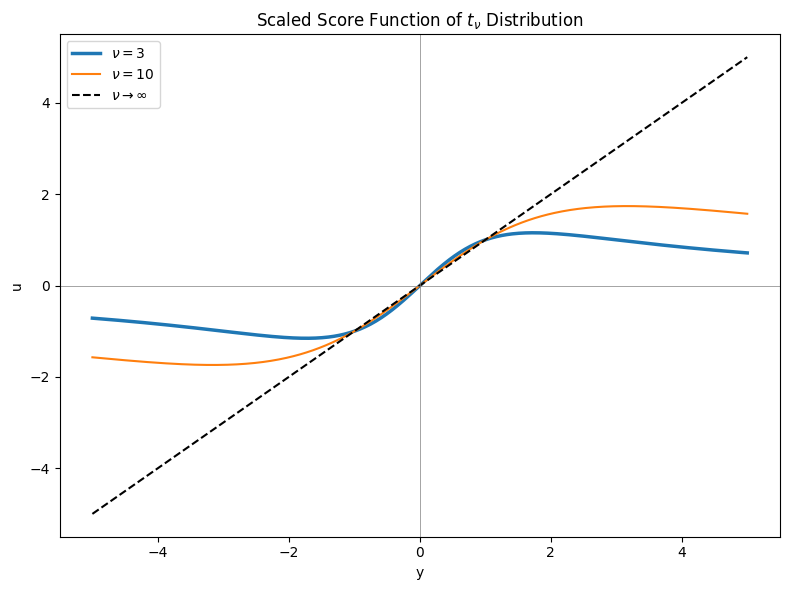

In [43]:
import numpy as np
import matplotlib.pyplot as plt

# Define y values (observations)
y = np.linspace(-5, 5, 500)

# Scaled score function for Student-t
def scaled_score(y, nu):
    return (nu + 1) * y / (nu + y**2)

# Compute scores
u_nu3 = scaled_score(y, nu=3)
u_nu10 = scaled_score(y, nu=10)
u_gaussian = y  # limit as nu → ∞

# Plotting
plt.figure(figsize=(8, 6))
plt.plot(y, u_nu3, label=r'$\nu = 3$', linewidth=2.5)
plt.plot(y, u_nu10, label=r'$\nu = 10$', linewidth=1.5)
plt.plot(y, u_gaussian, '--', label=r'$\nu \rightarrow \infty$', color='black')

plt.axhline(0, color='gray', linewidth=0.5)
plt.axvline(0, color='gray', linewidth=0.5)
plt.xlabel('y')
plt.ylabel('u')
plt.title('Scaled Score Function of $t_ν$ Distribution')
plt.legend()
plt.grid(False)
plt.tight_layout()
plt.show()
